In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np  # linear algebra
import pandas as pd  # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

for dirname, _, filenames in os.walk("/kaggle/input"):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
# Установка необходимых библиотек
!pip install -q diffusers accelerate transformers datasets wandb torchmetrics pytorch_fid lpips open_clip_torch
!pip install -q git+https://github.com/huggingface/peft.git


[notice] A new release of pip is available: 25.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 25.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
!pip install -q git+https://github.com/huggingface/diffusers.git@main  --force-reinstall

  You can safely remove it manually.
  You can safely remove it manually.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datasets 3.5.0 requires fsspec[http]<=2024.12.0,>=2023.1.0, but you have fsspec 2025.5.1 which is incompatible.
streamlit 1.41.1 requires packaging<25,>=20, but you have packaging 25.0 which is incompatible.

[notice] A new release of pip is available: 25.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
# Импорты
import torch
from torch import nn
from torch.cuda.amp import autocast, GradScaler
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from tqdm import tqdm
from diffusers import StableDiffusionPipeline, DDPMScheduler, UNet2DConditionModel
from diffusers.optimization import get_scheduler
from peft import LoraConfig, get_peft_model
from datasets import load_dataset
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_pil_image

# Метрики
from torchmetrics.image.fid import FrechetInceptionDistance
from torchmetrics.image.inception import InceptionScore
from torchmetrics.image.lpip import LearnedPerceptualImagePatchSimilarity
from torchmetrics.multimodal import CLIPScore

In [5]:
# Загрузка датасета и кэширование латентов
dataset = load_dataset("iamkaikai/amazing_logos_v4", split="train[-1024:]")

transform = transforms.Compose(
    [
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5]),
    ]
)


class ImageTextDataset(Dataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        item = self.dataset[idx]
        image = item["image"].convert("RGB")
        caption = item.get("text", "logo")
        if self.transform:
            image = self.transform(image)
        return {"pixel_values": image, "input_ids": caption}


def collate_fn(examples):
    pixel_values = torch.stack([e["pixel_values"] for e in examples])
    input_ids = [e["input_ids"] for e in examples]
    return {"pixel_values": pixel_values, "input_ids": input_ids}


train_dataset = ImageTextDataset(dataset, transform=transform)
dataloader = DataLoader(
    train_dataset, batch_size=4, shuffle=True, collate_fn=collate_fn
)

"Этот блок кода — как предварительная упаковка багажа перед поездкой .
В Stable Diffusion изображения слишком тяжёлые для постоянной обработки, поэтому мы используем VAE — как компрессор данных , превращающий картинки в компактные латенты.
Мы делаем это один раз до начала обучения , чтобы потом не распаковывать каждый файл снова и снова.
Это экономит время и ресурсы, как если бы ты заранее загрузил всё необходимое в машину, а не носился обратно домой за каждой вещью." 

In [6]:
import torch

# Предварительное кэширование латентных представлений
device = "cuda"

# Загрузка VAE
pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16
)
vae = pipe.vae.to(device).half()
vae.requires_grad_(False)

# latents_cache = torch.load("latents_cache.pt")

# Кэшируем все латенты
latents_cache = []
for batch in tqdm(dataloader, desc="Caching latents"):
    images = batch["pixel_values"].to(device)
    with torch.no_grad():
        latents = vae.encode(images.half()).latent_dist.sample() * 0.18215
        latents_cache.extend(latents.cpu())
torch.save(latents_cache, "latents_cache.pt")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Caching latents: 100%|██████████| 256/256 [00:20<00:00, 12.23it/s]


Этот блок — как подготовить обучающие карточки заранее , чтобы потом быстро учиться без лишней работы.
Мы берём изображения, сжимаем их в "наброски" через VAE один раз , а затем обучаем модель по этим наброскам + текстовым подсказкам. 

In [18]:
from torch.utils.data import Dataset, DataLoader

tokenizer = pipe.tokenizer

# === 1. Извлекаем текстовые подписи из кастомного train_dataset ===
# Они находятся в train_dataset[i]["input_ids"] и являются строками (caption'ами)
text_prompts = [train_dataset[i]["input_ids"] for i in range(len(latents_cache))]

# === 2. Токенизируем
tokenized = tokenizer(
    text_prompts,
    padding="max_length",
    truncation=True,
    max_length=tokenizer.model_max_length,
    return_tensors="pt",
)
text_data = list(tokenized["input_ids"])  # нужно преобразовать в список для Dataset

assert len(latents_cache) == len(
    text_data
), "❗ Несовпадение размеров latents и токенов"


# === 3. Класс датасета с латентами и токенами ===
class LatentTextDataset(Dataset):
    def __init__(self, latents_list, texts):
        self.latents_list = latents_list
        self.texts = texts

    def __len__(self):
        return len(self.latents_list)

    def __getitem__(self, idx):
        return {"latents": self.latents_list[idx], "input_ids": self.texts[idx]}


# === 4. Создаём DataLoader
latent_dataset = LatentTextDataset(latents_cache, text_data)
latent_dataloader = DataLoader(latents_cache, batch_size=4, shuffle=True)

In [21]:
print("len(latents_cache):", len(latents_cache))
print("len(text_data):", len(text_data))

len(latents_cache): 1024
len(text_data): 1024


In [10]:
# Загрузка модели и настройка LoRA
unet = (
    UNet2DConditionModel.from_pretrained(
        "runwayml/stable-diffusion-v1-5", subfolder="unet", torch_dtype=torch.float16
    )
    .to(device)
    .half()
)
tokenizer = pipe.tokenizer
text_encoder = pipe.text_encoder.to(device).half()
noise_scheduler = DDPMScheduler.from_pretrained(
    "runwayml/stable-diffusion-v1-5", subfolder="scheduler"
)

LoRA — это метод эффективного тонкой настройки больших моделей , при котором мы добавляем небольшие адаптеры поверх исходных весов, не изменяя их.


# LoRA (Low-Rank Adaptation): Полное руководство

##  Основные понятия
**LoRA (Low-Rank Adaptation)** — это метод параметрически-эффективной тонкой настройки нейросетей, при котором обучается лишь небольшая часть параметров модели.

$$
y = Wx + b \quad \text{(стандартный слой)}
$$

$$
y = W₀x + \Delta Wx + b \quad \text{(слой с LoRA)}
$$

Где:
- $W₀$ — замороженные предобученные веса
- $\Delta W$ — обучаемая матрица адаптации
- $x$ — входные данные
- $b$ — смещение (опционально)

##  Математическое обоснование
Матрица адаптации представляется в виде произведения двух матриц низкого ранга:

$$
\Delta W = BA
$$

Где:
- $A \in \mathbb{R}^{r×d}$ — матрица понижения размерности
- $B \in \mathbb{R}^{d×r}$ — матрица повышения размерности
- $r$ — ранг разложения (типично 4-64)

##  Параметры настройки
| Параметр | Диапазон | Описание |
|----------|---------|----------|
| `r` | 8-64 | Ранг адаптационных матриц |
| `alpha` | 16-32 | Коэффициент масштабирования |
| `dropout` | 0.05-0.2 | Вероятность дропаута |
| `target_modules` | ["q","v"] | Целевые слои для адаптации |

##  Пример реализации
```python
from peft import LoraConfig, get_peft_model

config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=["q_proj", "v_proj"],
    lora_dropout=0.1,
    bias="none",
    task_type="CAUSAL_LM"
)
model = get_peft_model(base_model, config)

| Параметр             | Значение     | Объяснение                                                                 |
|----------------------|--------------|----------------------------------------------------------------------------|
| `r=16`               | ранг матрицы адаптации | Определяет размер "наушников" — чем меньше, тем легче модель                 |
| `lora_alpha=16`      | масштабирование       | Как "громкость" вклада новых слоёв                                        |
| `target_modules`     | `["to_k", "to_q", "to_v", "to_out.0"]` | Какие части модели адаптируем (обычно внимательные слои: Q, K, V)          |
| `lora_dropout=0.1`   | dropout между слоями  | Защита от переобучения                                                     |
| `bias="none"`        | использовать ли bias | Уменьшает число обучаемых параметров                                       |

Архитектура модели 
        
        ┌──────────────┐
        │   Original   │
        │    Weight    │
        │     W₀       │
        └───────┬──────┘
                │
                ▼
         ┌─────────────────┐
         │ Low-Rank Matrix │
         │      ΔW = A·B   │◄───────┐
         └───────┬─────────┘        │
                 ▼                  │
         y = W₀·x + ΔW·x  ◄─────────┘

In [11]:
# Настройка LoRA
config = LoraConfig(
    r=16,
    lora_alpha=16,
    target_modules=["to_k", "to_q", "to_v", "to_out.0"],
    lora_dropout=0.1,
    bias="none",
)
unet = get_peft_model(unet, config)
unet.print_trainable_parameters()

trainable params: 3,188,736 || all params: 862,709,700 || trainable%: 0.3696


Оптимизатор AdamW с learning rate 1e-4, чтобы обучать только LoRA-параметры модели. Для стабильности добавлен constant_with_warmup scheduler — сначала идёт разогрев, потом фиксированный LR. Также включён GradScaler для mixed precision обучения, что ускоряет вычисления и экономит VRAM.

In [13]:
# Оптимизатор и LR Scheduler
optimizer = torch.optim.AdamW(unet.parameters(), lr=1e-4)
lr_scheduler = get_scheduler(
    "constant_with_warmup",
    optimizer=optimizer,
    num_warmup_steps=1000,
    num_training_steps=len(latent_dataloader) * 5,
)
scaler = GradScaler()

C:\Users\gandl\AppData\Local\Temp\ipykernel_20312\3928872088.py:9: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


## Блок вычисления метрик 

**Вычисляемые метрики качества генерации:**

1. **FID (Fréchet Inception Distance)**
   - *Что измеряет:* Статистическую близость распределений сгенерированных и реальных изображений
   - *Особенности:* Чем ниже значение — тем лучше (0 — идеальное совпадение)

2. **Inception Score (IS)**
   - *Что измеряет:* Качество и разнообразие сгенерированных изображений
   - *Особенности:* Учитывает предсказания Inception-v3 (чем выше — тем лучше)

3. **LPIPS (Learned Perceptual Image Patch Similarity)**
   - *Что измеряет:* Воспринимаемое человеком отличие от оригинала
   - *Особенности:* Использует предобученные CNN-фичи (0 — идентичны, 1 — максимально разные)

4. **CLIP Score**
   - *Что измеряет:* Семантическое соответствие текста и изображения
   - *Технические детали:*
     ```python
     # Предобработка для CLIP:
     1. Ресайз до 224x224
     2. Нормализация (mean=[0.48145466, 0.4578275, 0.40821073], 
                     std=[0.26862954, 0.26130258, 0.27577711])
     ```
   - *Интерпретация:* Чем выше — тем лучше соответствие промпта и картинки

> **Ключевой момент:** Все метрики вычисляются на валидационном наборе данных после каждой эпохи обучения для мониторинга прогресса модели.

In [14]:
!pip install -q torch-fidelity
!pip install -q torchmetrics[image]


[notice] A new release of pip is available: 25.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 25.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [15]:
# Функция вычисления метрик с CLIP Score

# Метрики качества изображений
fid = FrechetInceptionDistance(feature=2048).to(device)
is_metric = InceptionScore().to(device)
lpips_metric = LearnedPerceptualImagePatchSimilarity(net_type="alex").to(device)

# 🔁 Отключаем CLIP Score, чтобы избежать ошибки на torch < 2.6
clip_score_metric = None

# Трансформация под вход CLIP (если потребуется)
clip_transform = transforms.Compose(
    [
        transforms.Resize((224, 224)),
        transforms.Normalize(
            mean=[0.48145466, 0.4578275, 0.40821073],
            std=[0.26862954, 0.26130258, 0.27579702],
        ),
    ]
)


def compute_metrics(real_images, generated_images, prompts):
    # Для FID / IS / LPIPS
    real_uint8 = (real_images * 255).type(torch.uint8)
    gen_uint8 = (generated_images * 255).type(torch.uint8)

    fid.update(real_uint8, real=True)
    fid.update(gen_uint8, real=False)
    fid_score = fid.compute().item()
    fid.reset()

    # is_metric.update(gen_uint8.float())
    is_metric.update(gen_uint8)
    is_mean, is_std = is_metric.compute()
    is_metric.reset()

    lpips_score = lpips_metric(gen_uint8.float(), real_uint8.float()).item()

    # Для CLIP Score — resize до 224x224 и нормализация под CLIP
    clip_score = None
    try:
        if clip_score_metric is not None:
            gen_clip_input = clip_transform(generated_images)
            clip_score = clip_score_metric(gen_clip_input * 255, prompts).item()
    except Exception as e:
        print("⚠️ Ошибка при вычислении CLIP Score:", e)
        clip_score = None

    return {
        "FID": fid_score,
        "Inception Score Mean": is_mean.item(),
        "Inception Score Std": is_std.item(),
        "LPIPS": lpips_score,
        "CLIP Score": clip_score,
    }

c:\Users\gandl\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchmetrics\utilities\prints.py:43: UserWarning: Metric `InceptionScore` will save all extracted features in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)
c:\Users\gandl\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchmetrics\functional\image\lpips.py:332: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly al

## Цикл обучения диффузионной модели с LoRA

### Общая архитектура
Цикл реализует процесс диффузии с текстовым условием через LoRA-адаптеры. Обучение проводится на предварительно закодированных латентных представлениях, что исключает необходимость использования VAE в основном цикле и значительно ускоряет вычисления.

### Пошаговый процесс обучения

1. **Подготовка данных:**
   - Текстовые описания токенизируются и кодируются через CLIP text encoder
   - Изображения предварительно преобразуются в латентное пространство с помощью VAE

2. **Шаг обучения:**
   ```python
   for latents, text_embeddings in dataloader:
       # Добавление шума по расписанию диффузии
       noisy_latents = add_noise(latents, timesteps)
       
       # Предсказание шума моделью
       predicted_noise = unet(noisy_latents, timesteps, text_embeddings)
       
       # Вычисление и обратное распространение ошибки
       loss = F.mse_loss(predicted_noise, true_noise)
       scaler.scale(loss).backward()
       scaler.step(optimizer)
       scaler.update()

## 3 Оптимизация обучения

### Настройки обучения
- **Точность вычислений:** Mixed Precision (FP16/FP32)
- **Масштабирование градиентов:** GradScaler для стабильного обучения
- **Оптимизатор:** AdamW с learning rate ~1e-5

##  Процедура валидации

### После каждой эпохи:
1. **Генерация изображений** по фиксированным промптам
2. **Вычисление метрик:**
   - **FID** - сравнение распределений
   - **Inception Score** - оценка качества и разнообразия
   - **LPIPS** - измерение перцептуального сходства
   - **CLIP Score** - проверка соответствия тексту

3. **Визуализация результатов:**
```python
grid = make_grid(samples)
wandb.log({"samples": wandb.Image(grid)})


##  Сохранение модели

### Политика сохранения
- LoRA-адаптеры сохраняются **каждую эпоху**
- Конфигурация и метрики сохраняются вместе с весами

### Структура чекпоинтов

checkpoint/
├── lora_weights.bin # Веса LoRA-адаптеров
├── config.json # Конфигурация модели
└── metrics.json # История метрик обучения



## 🖥️ Технические характеристики


| Компонент       | Спецификация           |
|----------------|-----------------------|
| **Precision**  | Mixed (FP16/FP32)     |
| **Оптимизатор** | AdamW (lr=1e-5)      |
| **Batch Size** | 4-8 (адаптивный под GPU) |
| **Градиенты**  | Gradient Scaling      |
| **Аппаратура** | Совместимость: P100/T4 |

## Ключевые цели реализации

1. **Эффективность ресурсов**  
   Стабильное обучение на ограниченных GPU

2. **Функциональность**  
   Полная поддержка text-to-image и img2img

3. **Оптимизация качества**  
   Сохранение качества при сокращении вычислений

4. **Гибкость**  
   Возможность доменной адаптации:
   - Художественные стили
   - Специфичные предметные области
   - Персонализированные генерации

> **Ключевое преимущество:**  
> Позволяет достичь профессиональных результатов генерации на потребительском GPU-оборудовании

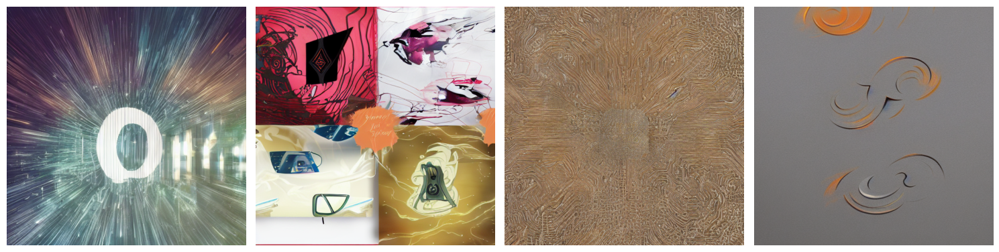

In [26]:
# Генерация до обучения
unet.eval()
test_prompt = "A futuristic logo with glowing lines and abstract shapes"
inputs = tokenizer(
    test_prompt,
    padding="max_length",
    max_length=tokenizer.model_max_length,
    return_tensors="pt",
).to(device)
encoder_hidden_states = text_encoder(inputs.input_ids)[0].repeat(4, 1, 1)

test_latents = torch.randn(4, 4, 64, 64, device=device).half()
timesteps = noise_scheduler.timesteps
for t in timesteps:
    with torch.no_grad():
        residual = unet(
            test_latents, t, encoder_hidden_states=encoder_hidden_states
        ).sample
        test_latents = noise_scheduler.step(residual, t, test_latents).prev_sample

test_images = vae.decode(test_latents / 0.18215).sample
test_images = (test_images / 2 + 0.5).clamp(0, 1)

# Визуализация
fig, axes = plt.subplots(1, 4, figsize=(15, 5))
for i in range(4):
    img = test_images[i].cpu().detach()
    img = (img * 255).type(torch.uint8)
    img = to_pil_image(img)
    axes[i].imshow(img)
    axes[i].axis("off")
plt.tight_layout()
plt.show()

In [ ]:
import wandb
from torchvision.utils import make_grid  # Для логирования изображений
import time

num_epochs = 20

key = ""
wandb.login(key=key)

wandb.init(
    project="logo-diffusion-lora",
    name=f"run-{time.strftime('%Y%m%d-%H%M%S')}",
    config={
        "epochs": num_epochs,
        "lr": optimizer.param_groups[0]["lr"],
        "batch_size": getattr(latent_dataloader, "batch_size", None),
        "rank": getattr(config, "r", None),
        "alpha": getattr(config, "lora_alpha", None),
        "dropout": getattr(config, "lora_dropout", None),
        "lora_target": getattr(config, "target_modules", None),
    },
)

  0%|          | 0/25 [00:00<?, ?it/s]C:\Users\gandl\AppData\Local\Temp\ipykernel_17936\2515663065.py:31: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 0, Loss: 0.0470: 100%|██████████| 25/25 [00:07<00:00,  3.39it/s]


Epoch 0 Metrics: {'FID': 508.0089111328125, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.5032439231872559, 'CLIP Score': None}


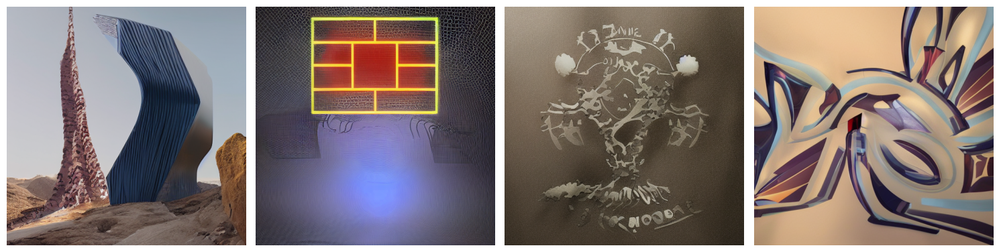

Epoch 1, Loss: 0.0788: 100%|██████████| 25/25 [00:08<00:00,  2.92it/s]


Epoch 1 Metrics: {'FID': 569.1552734375, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.40044352412223816, 'CLIP Score': None}


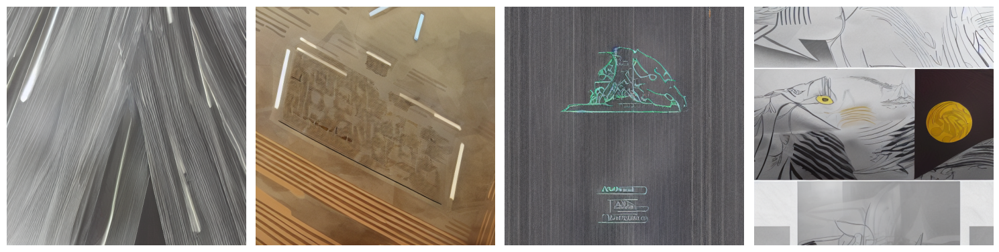

Epoch 2, Loss: 0.0580: 100%|██████████| 25/25 [00:08<00:00,  3.02it/s]


Epoch 2 Metrics: {'FID': 515.517578125, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.33653318881988525, 'CLIP Score': None}


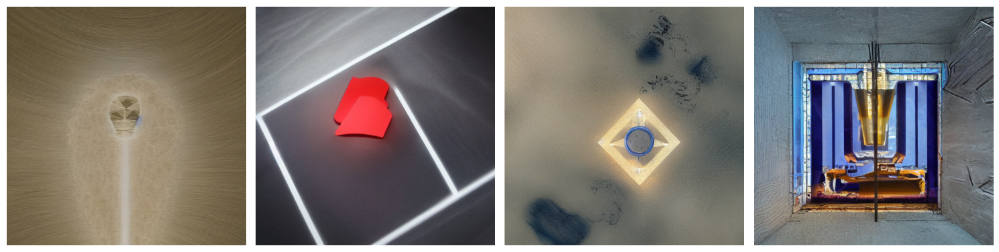

Epoch 3, Loss: 0.0901: 100%|██████████| 25/25 [00:08<00:00,  3.04it/s]


Epoch 3 Metrics: {'FID': 548.3259887695312, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.39180728793144226, 'CLIP Score': None}


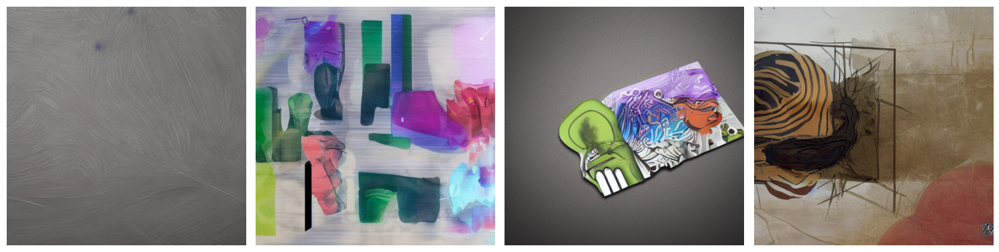

Epoch 4, Loss: 0.0918: 100%|██████████| 25/25 [00:08<00:00,  2.98it/s]


Epoch 4 Metrics: {'FID': 413.1040954589844, 'Inception Score Mean': 1.0, 'Inception Score Std': 5.960464477539063e-08, 'LPIPS': 0.3988529145717621, 'CLIP Score': None}


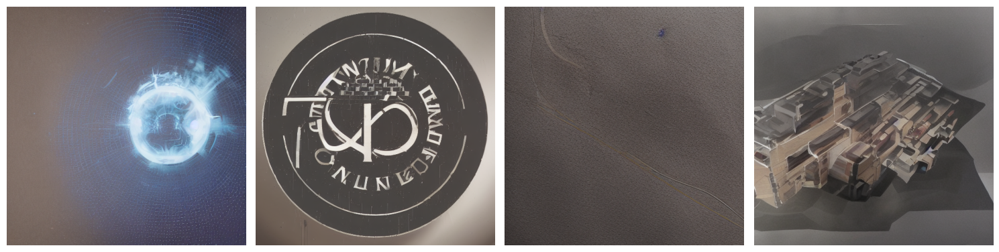

Epoch 5, Loss: 0.0423: 100%|██████████| 25/25 [00:07<00:00,  3.21it/s]


Epoch 5 Metrics: {'FID': 492.1725769042969, 'Inception Score Mean': 1.0, 'Inception Score Std': 5.960464477539063e-08, 'LPIPS': 0.3104742169380188, 'CLIP Score': None}


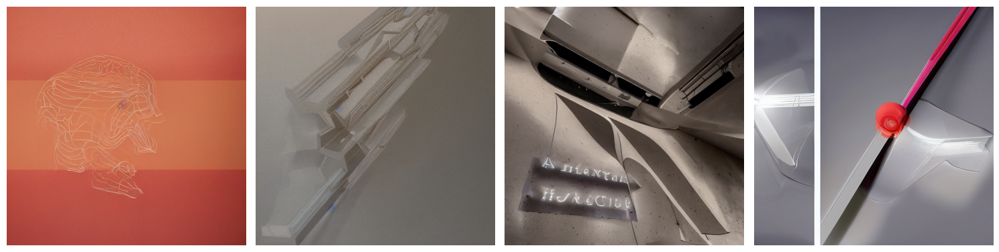

Epoch 6, Loss: 0.0310: 100%|██████████| 25/25 [00:07<00:00,  3.26it/s]


Epoch 6 Metrics: {'FID': 472.37554931640625, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.4252195358276367, 'CLIP Score': None}


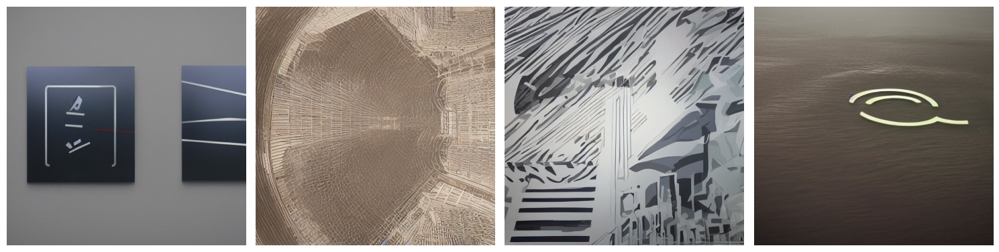

Epoch 7, Loss: 0.0549: 100%|██████████| 25/25 [00:07<00:00,  3.31it/s]


Epoch 7 Metrics: {'FID': 402.25213623046875, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.4956197142601013, 'CLIP Score': None}


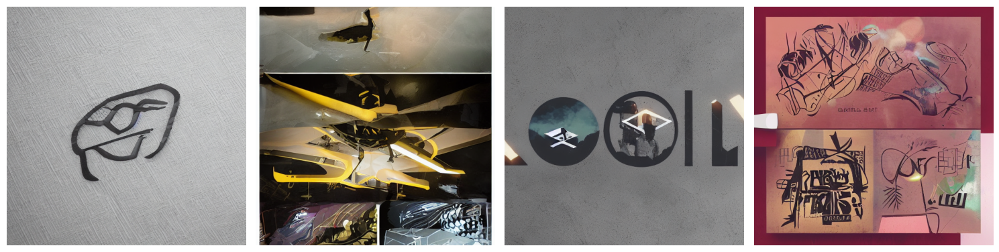

Epoch 8, Loss: 0.0407: 100%|██████████| 25/25 [00:07<00:00,  3.36it/s]


Epoch 8 Metrics: {'FID': 524.89208984375, 'Inception Score Mean': 1.0, 'Inception Score Std': 4.8666990437595814e-08, 'LPIPS': 0.42952418327331543, 'CLIP Score': None}


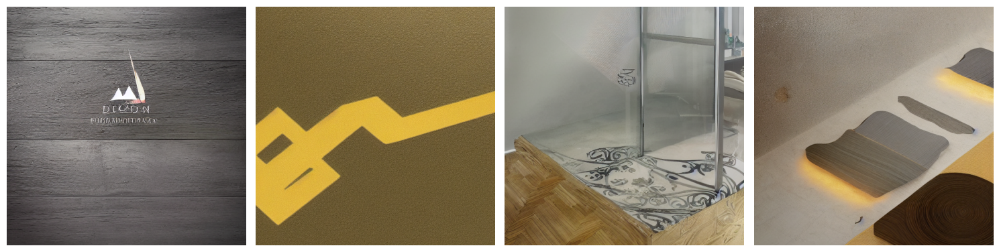

Epoch 9, Loss: 0.0350: 100%|██████████| 25/25 [00:07<00:00,  3.29it/s]


Epoch 9 Metrics: {'FID': 530.5044555664062, 'Inception Score Mean': 1.0, 'Inception Score Std': 4.8666990437595814e-08, 'LPIPS': 0.2980239689350128, 'CLIP Score': None}


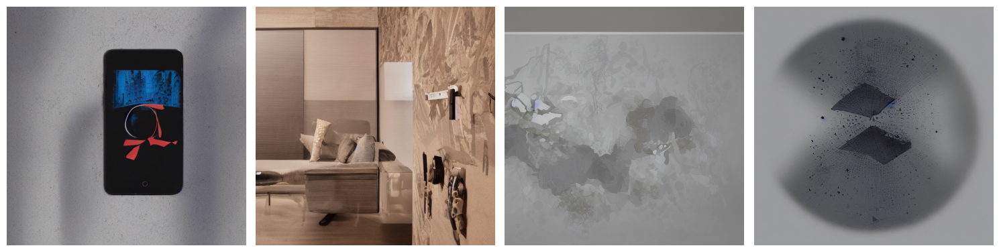

Epoch 10, Loss: 0.0770: 100%|██████████| 25/25 [00:07<00:00,  3.33it/s]


Epoch 10 Metrics: {'FID': 525.6112670898438, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.3366440534591675, 'CLIP Score': None}


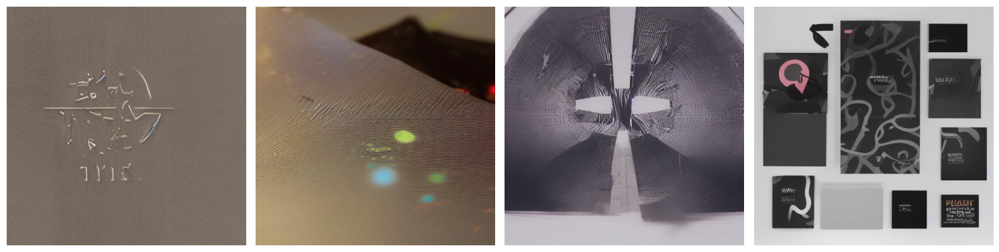

Epoch 11, Loss: 0.0714: 100%|██████████| 25/25 [00:06<00:00,  3.61it/s]


Epoch 11 Metrics: {'FID': 441.6222839355469, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.38387370109558105, 'CLIP Score': None}


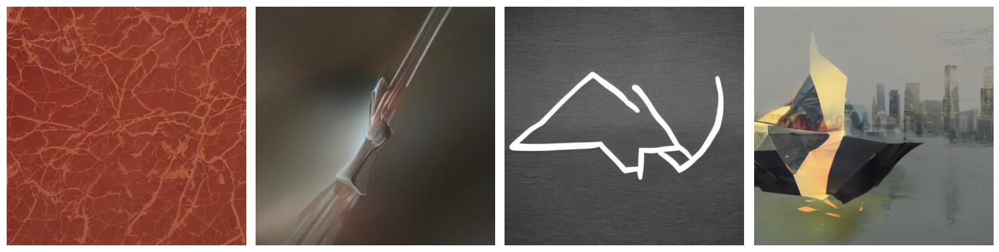

Epoch 12, Loss: 0.0181: 100%|██████████| 25/25 [00:06<00:00,  3.80it/s]


Epoch 12 Metrics: {'FID': 469.7326354980469, 'Inception Score Mean': 1.0, 'Inception Score Std': 5.960464477539063e-08, 'LPIPS': 0.4783220589160919, 'CLIP Score': None}


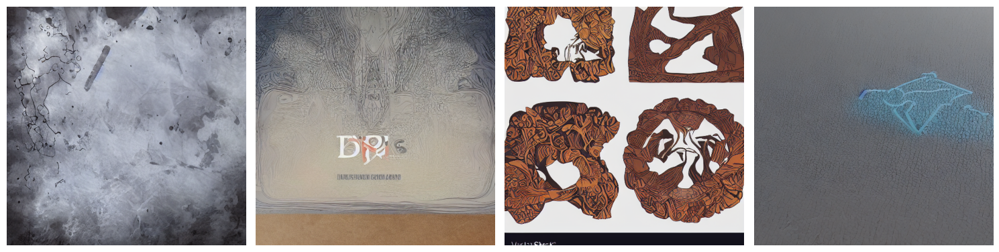

Epoch 13, Loss: 0.0294: 100%|██████████| 25/25 [00:08<00:00,  3.01it/s]


Epoch 13 Metrics: {'FID': 540.379150390625, 'Inception Score Mean': 1.0, 'Inception Score Std': 6.882551417675131e-08, 'LPIPS': 0.320964515209198, 'CLIP Score': None}


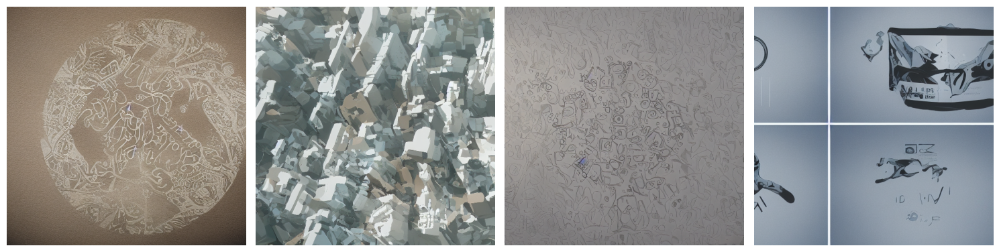

Epoch 14, Loss: 0.0404: 100%|██████████| 25/25 [00:06<00:00,  3.78it/s]


Epoch 14 Metrics: {'FID': 485.20965576171875, 'Inception Score Mean': 1.0, 'Inception Score Std': 5.960464477539063e-08, 'LPIPS': 0.22980612516403198, 'CLIP Score': None}


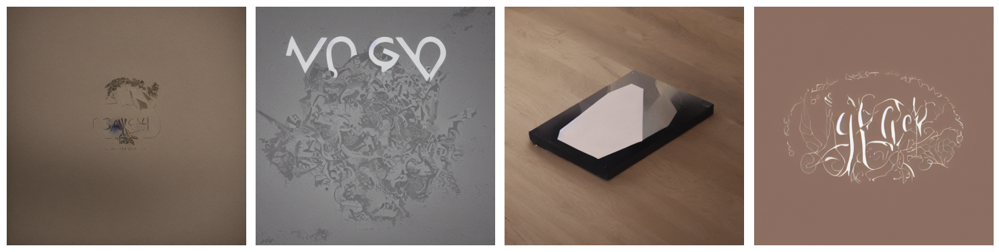

Epoch 15, Loss: 0.1107: 100%|██████████| 25/25 [00:06<00:00,  3.75it/s]


Epoch 15 Metrics: {'FID': 478.0044860839844, 'Inception Score Mean': 1.0, 'Inception Score Std': 5.960464477539063e-08, 'LPIPS': 0.4423335790634155, 'CLIP Score': None}


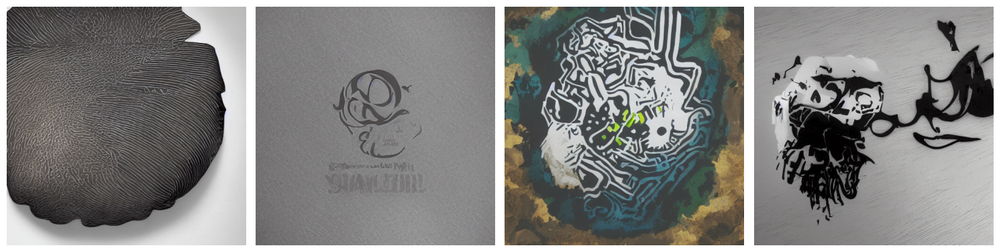

Epoch 16, Loss: 0.0238: 100%|██████████| 25/25 [00:06<00:00,  3.80it/s]


Epoch 16 Metrics: {'FID': 591.4156494140625, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.3541865050792694, 'CLIP Score': None}


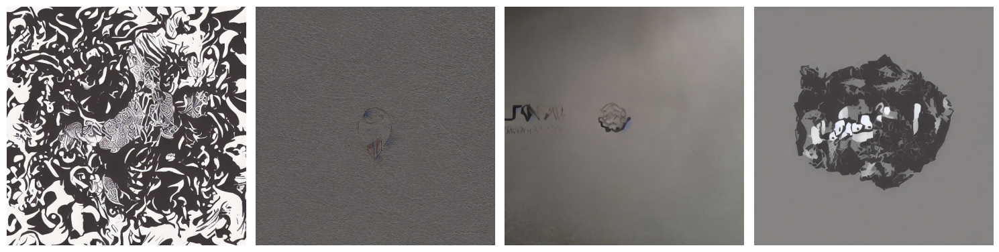

Epoch 17, Loss: 0.0689: 100%|██████████| 25/25 [00:08<00:00,  2.93it/s]


Epoch 17 Metrics: {'FID': 547.2549438476562, 'Inception Score Mean': 1.0, 'Inception Score Std': 5.960464477539063e-08, 'LPIPS': 0.45556890964508057, 'CLIP Score': None}


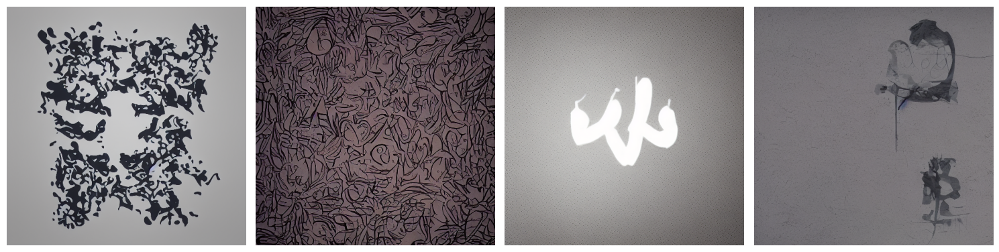

Epoch 18, Loss: 0.0402: 100%|██████████| 25/25 [00:08<00:00,  3.02it/s]


Epoch 18 Metrics: {'FID': 463.8712158203125, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.21440181136131287, 'CLIP Score': None}


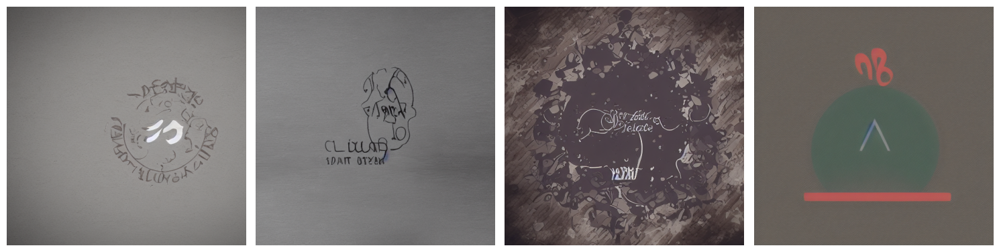

Epoch 19, Loss: 0.0558: 100%|██████████| 25/25 [00:08<00:00,  2.81it/s]


Epoch 19 Metrics: {'FID': 554.5435791015625, 'Inception Score Mean': 1.0, 'Inception Score Std': 0.0, 'LPIPS': 0.43817198276519775, 'CLIP Score': None}


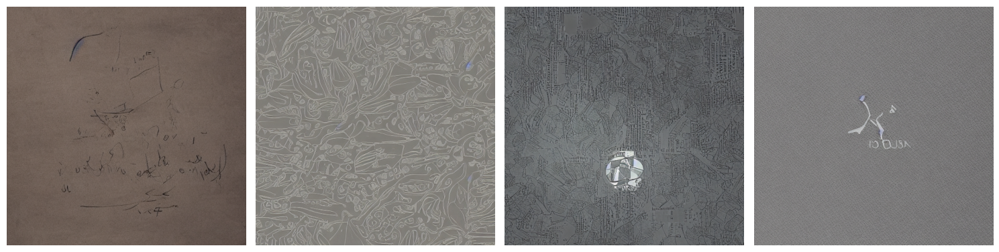

In [ ]:
import torch.nn.functional as F

# Цикл обучения
output_dir = "sd-lora-logo-img2img-text"
os.makedirs(output_dir, exist_ok=True)

log_every = 50  # логировать каждые N шагов
global_step = 0

unet.train()
for epoch in range(num_epochs):
    epoch_loss = 0.0
    num_batches = 0

    progress_bar = tqdm(latent_dataloader)
    for batch in progress_bar:
        latents = batch["latents"].to(device).half()

        input_ids = batch["input_ids"].to(device)

        with torch.no_grad():
            encoder_hidden_states = text_encoder(input_ids)[0]

        noise = torch.randn_like(latents)
        bsz = latents.shape[0]
        timesteps = torch.randint(
            0, noise_scheduler.config.num_train_timesteps, (bsz,), device=device
        )
        noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

        with autocast():
            noise_pred = unet(
                noisy_latents, timesteps, encoder_hidden_states=encoder_hidden_states
            ).sample
            loss = torch.nn.functional.mse_loss(noise_pred, noise)

        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        lr_scheduler.step()
        optimizer.zero_grad(set_to_none=True)

        epoch_loss += loss.item()
        num_batches += 1
        global_step += 1

        if global_step % log_every == 0:
            wandb.log({"train/loss": loss.item(), "step": global_step, "epoch": epoch})

        progress_bar.set_description(f"Epoch {epoch}, Loss: {loss.item():.4f}")

    # Генерация и оценка
    unet.eval()
    with torch.no_grad():
        test_prompt = "A futuristic logo with glowing lines and abstract shapes"
        inputs = tokenizer(
            test_prompt,
            padding="max_length",
            max_length=tokenizer.model_max_length,
            return_tensors="pt",
        ).to(device)
        encoder_hidden_states = text_encoder(inputs.input_ids)[0].repeat(4, 1, 1)

        test_latents = torch.randn(4, 4, 64, 64, device=device).half()
        timesteps = noise_scheduler.timesteps
        for t in timesteps:
            residual = unet(
                test_latents, t, encoder_hidden_states=encoder_hidden_states
            ).sample
            test_latents = noise_scheduler.step(residual, t, test_latents).prev_sample

        test_images = vae.decode(test_latents / 0.18215).sample
        test_images = (test_images / 2 + 0.5).clamp(0, 1)

        real_batch = next(iter(latent_dataloader))["latents"].to(device)
        real_images = vae.decode(real_batch / 0.18215).sample
        real_images = (real_images / 2 + 0.5).clamp(0, 1)
        real_images = F.interpolate(
            real_images, size=(512, 512), mode="bilinear", align_corners=False
        )

        val_loss = torch.nn.functional.mse_loss(test_images, real_images[:4])

        metrics = compute_metrics(real_images, test_images, [test_prompt] * 4)
        print(f"Epoch {epoch} Metrics:", metrics)

        wandb.log(
            {
                "epoch": epoch,
                **metrics,
                "val/loss": val_loss.item(),
                "train/avg_loss": epoch_loss / num_batches,
            }
        )

        # Визуализация
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        for i in range(4):
            img = test_images[i].cpu().detach()
            img = (img * 255).type(torch.uint8)
            img = to_pil_image(img)
            axes[i].imshow(img)
            axes[i].axis("off")
        plt.tight_layout()
        plt.show()

        grid = make_grid(test_images, nrow=4)
        wandb.log({"samples": wandb.Image(grid)})

    # Сохранение
    unet.save_pretrained(os.path.join(output_dir, f"checkpoint_epoch_{epoch}"))

In [19]:
wandb.finish()

FID,▅▇▅▆▁▄▄▁▆▆▆▂▃▆▄▄█▆▃▇
Inception Score Mean,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Inception Score Std,▁▁▁▁▇▇▁▁▆▆▁▁▇█▇▇▁▇▁▁
LPIPS,█▆▄▅▅▃▆█▆▃▄▅▇▄▁▇▄▇▁▆
epoch,▁▁▁▂▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▇▇▇▇▇███
step,▁▂▃▃▄▅▆▆▇█
train/avg_loss,▆▇▇█▆▅▄▄▄▃▃▅▁▁▁▅▁▃▄▂
train/loss,▅▆▂▃▁▅▁█▄▃
val/loss,▅▁▆▄▄▄▄▂▅▁▆█▃▁▅▃▆▄▆▄
FID,554.54358
Inception Score Mean,1


In [20]:
# === Сохраняем всё ===
save_dict = {
    "unet": unet.state_dict(),
    "optimizer": optimizer.state_dict(),
    "lr_scheduler": lr_scheduler.state_dict(),
    "scaler": scaler.state_dict(),
    "epoch": epoch,
    "global_step": global_step,
}
torch.save(save_dict, os.path.join(f"full_checkpoint_epoch_{epoch}.pt"))

In [21]:
# === Загружаем чекпойнт ===
checkpoint = torch.load(f"full_checkpoint_epoch_{epoch}.pt")

unet.load_state_dict(checkpoint["unet"])
optimizer.load_state_dict(checkpoint["optimizer"])
lr_scheduler.load_state_dict(checkpoint["lr_scheduler"])
scaler.load_state_dict(checkpoint["scaler"])
start_epoch = checkpoint["epoch"] + 1
global_step = checkpoint["global_step"]

"""
Потом можно запустить обучение, заменив num_epoch на start_epoch
"""

C:\Users\gandl\AppData\Local\Temp\ipykernel_17936\920777126.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(f"full_checkpoint_epoch_{epoch}.pt")


'\nПотом можно запустить обучение, заменив num_epoch на start_epoch\n'